# Pix2Pix

**Marc Balle Sánchez**

## Introducción 

En esta práctica se busca un primer contacto con las redes GANs (*Generative adversarial Networks*), así como la realización del código necesario para cargar las imágenes y aplicarles una serie de transformaciones geométricas de forma aleatoria (*random jittering*). 

### GANs
Las GANs fueron introducidas por primera vez por Ian Goodfellow y compañeros en el año 2014. Se introdujeron en un momento donde los modelos generativos no gozaban de mucha fama debido a las complejidades que estos presentaban. 

La filosofía de este tipo de redes radica en la forma de entrenamiento. En ellas, un generador *G* compite contra con discriminador *D* de tal forma que *G* intenta crear imágenes que *D* no pueda discernir de aquellas imágenes reales. De esta forma se produce un entrenamiento simultáneo: *G* intenta mejorar su capacidad de generar imágenes realistas, mientras que *D* intenta ser cada vez mejor en la tarea discriminatoria. Esto puede traducirse matemáticamente como: 

$\min\limits_{G} \max\limits_{D} V(D,G) = \mathbb{E}_{x \sim p_{data}(x)} [\ \log D(x)]\ + \mathbb{E}_{z \sim p_z(z)} [\ \log(1 - D(G(z))]\ $

Donde $D(x)$ corresponderá a la probabilidad de ser verdadera una imagen $x$ del mundo real y $D(G(z))$ a la probabilidad de que una imagen generada a partir de un vector ruido $z$ sea real. 

### cGANs

Las cGANs (*conditional Generative Adversarial Networks*) son una modificación de las GANs originales. Este tipo de red permite como entrada al generador una imagen que, como bien indica su nombre, condicionará la salida de tal forma que se generen imágenes pertenecientes a un subcojunto del dominio original o pertenecientes a un dominio concreto. Este tipo de redes son muy útiles en aplicaciones donde se pretende realizar una transformación imagen $\to$ imagen. En el caso concreto de esta práctica, la imagen de entrada es un boceto de un bolso, y la imagen de salida es el bolso real. Es decir, *G* en este caso se encargará de colorear y darle la textura correcta al bolso a partir de su boceto. Este tipo de transformaciones también se conocen con el nombre de *pix2pix* haciendo referencia a una transformaciones píxel a píxel de la imagen de entrada a la imagen de salida, ambas con el mismo tamaño. De esta forma, su formulación matemática quedaría descrita como sigue: 

$\min\limits_{G} \max\limits_{D} V(D,G) = \mathbb{E}_{x,y} [\ \log D(x,y)]\ + \mathbb{E}_{x,z} [\ \log(1 - D(x,G(x,z))]\ $

Donde $x$ es la imagen de entrada (el boceto), $y$ es la imagen real y $z$ es ruido. Sin embargo, a esta función matemática después se verá que se le añade un componente más, la pérdida L1 o MAE.

## Se importa TensorFlow y otras librerías

Primero de todo se importan las librerías necesarias para el desarrollo del proyecto. Además se instala otra librería con pip, ``tensorboard``. Este permitirá monitorizar determinadas variables (principalmente pérdidas) a lo largo del proceso de entrenamiento para posteriormente graficarlas.

In [1]:
import numpy as np
import cv2 
import tensorflow as tf

import os
import time

from matplotlib import pyplot as plt
from IPython import display
from numpy import savez_compressed, load

In [ ]:
!pip install -U tensorboard

## Carga del dataset

Se puede descargar un zip con las imágenes [aquí](https://people.eecs.berkeley.edu/~tinghuiz/projects/pix2pix/datasets). 

A diferencia de prácticas anteriores, no se va a aplicar la técnica de *data augmentation*. En lugar de ello, se evaluará el efecto de emplear *random jittering*. El *random jittering* consiste en aplicar, de forma aleatoria, transformaciones geométricas a las imágenes. Estas transformaciones son las siguientes: 

1. Aumentar el tamaño de la imagen, tanto el ancho como alto. 
2. Reducir el tamaño de la imagen al original de forma aleatoria. Posteriormente se verá a qué se refiere con aleatorio. 
3. Rotar horizontalmente la imagen de forma aleatoria. 

#### Descarga de los datos 

Cabe destacar que la descarga es muy lenta, ya que el archivo comprimido tiene un tamaño de 8GB. Posteriormente se deberá seleccionar únicamente un subconjunto de imágenes de tamaño adecuado para trabajar sin fallos de memoria. 

In [5]:
!cd /content

In [6]:
!wget https://people.eecs.berkeley.edu/~tinghuiz/projects/pix2pix/datasets/edges2handbags.tar.gz

--2021-02-13 11:01:25--  https://people.eecs.berkeley.edu/~tinghuiz/projects/pix2pix/datasets/edges2handbags.tar.gz
Resolving people.eecs.berkeley.edu (people.eecs.berkeley.edu)... 128.32.244.190
Connecting to people.eecs.berkeley.edu (people.eecs.berkeley.edu)|128.32.244.190|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 8556411008 (8.0G) [application/x-gzip]
Saving to: ‘edges2handbags.tar.gz’

edges2handbags.tar. 100%[===================>]   7.97G  4.01MB/s    in 29m 58s 

2021-02-13 11:31:23 (4.54 MB/s) - ‘edges2handbags.tar.gz’ saved [8556411008/8556411008]



In [ ]:
!tar -xzvf edges2handbags.tar.gz

In [8]:
!rm edges2handbags.tar.gz

Una vez descargados, se comprueba el formato de las imágenes. Como se aprecia, en una misma imagen viene concatenadas la imagen de entrada (el boceto) y la imagen objetivo. Será necesario separarlas en dos conjuntos distintos. 

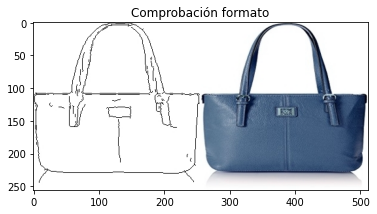

In [9]:
plt.clf()
path = './edges2handbags/val/100_AB.jpg'
image = cv2.imread(path)
plt.imshow(image)
plt.title('Comprobación formato')
plt.show()

A raíz del problema anterior, se crea la función ``load_images``, encargada de cargar las imágenes en el formato adecuado. Además de separar el boceto de la imagen objeto, esta función realizar un cast de la imagen a tipo ``float32`` para evitar futuros problemas. Además, se define la imagen en el dominio [-1,1] en lugar de [0,255]. Estas dos útlimas modificaciones se justificarán más adelante cuando se hable de la función de périda del generador. 

Para la división de la imagen se recomienda  que el ancho final de la imagen cargada sea múltiplo de 2 para obtener imágenes de igual ancho. Por otra parte, es aconsejable mantener una proporción 2:1 (e.g., 512,256) en el tamaño final de la imagen cargada, de tal forma que al dividirla queden imágenes cuadradas. 

In [10]:
def load_images (path, size = (512,256), prop = 1): #size = (width, height) 

  files = os.listdir(path)
  number_files = len(files)
  num = round(prop*number_files)
  edges, tar = list(), list()
  i = 0
  for filename in os.listdir(path): 
    if i < num: 
      im = cv2.imread(path + filename)
      im = np.float32(im) # casting a float32 para evitar incongruencias en el cálculo más adelante
      im = cv2.resize(im, size) # se dota a la imagen de un tamaño adecuado para su división en dos
      im = im/255 # imágenes entre 0 y 1
      im = im * (1-(-1)) + (-1) #imágenes entre -1 y 1
      edge_img, handbag_img = im[:, :256], im[:,256:] #boceto y target por separado
      edges.append(edge_img) 
      tar.append(handbag_img)
      i += 1
    else: 
      break
  return [np.asarray(edges), np.asarray(tar)]

Para hacerse una idea del tamaño de los conjuntos de entrenamiento y validación, se imprimen el número de imágenes por cada uno. 

In [11]:
path_train = './edges2handbags/train/'
path_val = './edges2handbags/val/'
files_train = os.listdir(path_train)
files_val = os.listdir(path_val)
number_files_train = len(files_train)
number_files_val = len(files_val)
print('Número de imágenes de train: ', number_files_train)
print('Número de imágenes de validación: ', number_files_val)

Número de imágenes de train:  138567
Número de imágenes de validación:  200


Como puede observarse, el conjunto de entrenamiento consta de casi 140000 imágenes. Este número es demasiado grande como para caber en memoria RAM, por lo que únicamente se seleccionará un subconjunto de imágenes de tamaño adecuado. 

La función ``load_images`` está dotada del parámetro ``prop``, el cual permite cargar solamente una proporción determinada del conjunto total de imágenes. Para el caso del set de entrenamiento, únciamente se carga el 1.5%, que son 2079 imágenes. Del conjunto de validación se carga únicamente el 10% ya que no hará falta todo el set para realizar la comprobación del modelo. Cabe recordar que posteriormente ambos conjunto serán ampliados tras el proceso de *jittering*. 

In [12]:
[edges_train, target_train] = load_images(path = path_train, size = (512, 256), prop = 0.015) #1.5% del train
[edges_val, target_val] = load_images(path = path_val, size = (512, 256), prop = 0.10)
print('Train loaded: ', edges_train.shape, target_train.shape)
print('Validation loaded: ',edges_val.shape, target_val.shape)

Train loaded:  (2079, 256, 256, 3) (2079, 256, 256, 3)
Validation loaded:  (20, 256, 256, 3) (20, 256, 256, 3)


Se realiza una comprobación rápida para confirmar que las imágenes están definidas entre [-1, 1] y son de tipo ``float32``

In [13]:
np.unique(target_train[1])

array([-1.        , -0.99215686, -0.9843137 , -0.9764706 , -0.96862745,
       -0.9607843 , -0.9529412 , -0.94509804, -0.9372549 , -0.92941177,
       -0.92156863, -0.9137255 , -0.90588236, -0.8980392 , -0.8901961 ,
       -0.88235295, -0.8745098 , -0.8666667 , -0.85882354, -0.8509804 ,
       -0.84313726, -0.8352941 , -0.827451  , -0.81960785, -0.8117647 ,
       -0.8039216 , -0.79607844, -0.7882353 , -0.78039217, -0.77254903,
       -0.7647059 , -0.75686276, -0.7490196 , -0.7411765 , -0.73333335,
       -0.7254902 , -0.7176471 , -0.70980394, -0.7019608 , -0.69411767,
       -0.6862745 , -0.6784314 , -0.67058825, -0.6627451 , -0.654902  ,
       -0.64705884, -0.6392157 , -0.6313726 , -0.62352943, -0.6156863 ,
       -0.60784316, -0.6       , -0.5921569 , -0.58431375, -0.5764706 ,
       -0.5686275 , -0.56078434, -0.5529412 , -0.54509807, -0.5372549 ,
       -0.5294118 , -0.52156866, -0.5137255 , -0.5058824 , -0.4980392 ,
       -0.49019605, -0.4823529 , -0.47450978, -0.46666664, -0.45

Una comprobación visual para cerciorarse de que las imágenes se han separado correctamente y que existe una coherencia u orden entre los conjuntos de bocetos y *targets*. 

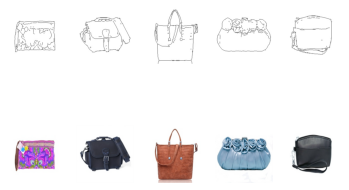

In [14]:
plt.clf()
n_samples = 5
for i in range(0,n_samples): 
  plt.subplot(2, n_samples, i+1)
  #plt.imshow(edges_train[i].astype(np.uint8))
  plt.imshow(edges_train[i] * 0.5 + 0.5)
  plt.axis('off')

for i in range(0,n_samples):
  plt.subplot(2,n_samples, 1+n_samples+i)
  plt.imshow(target_train[i] * 0.5 + 0.5)
  plt.axis('off')

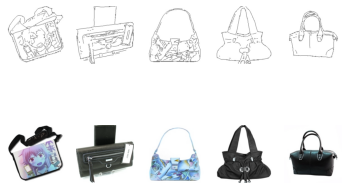

In [15]:
plt.clf()
for i in range(0,n_samples): 
  plt.subplot(2, n_samples, i+1)
  #plt.imshow(edges_val[i].astype(np.uint8))
  plt.imshow(edges_val[i] * 0.5 + 0.5)
  plt.axis('off')

for i in range(0,n_samples):
  plt.subplot(2,n_samples, 1+n_samples+i)
  #plt.imshow(target_val[i].astype(np.uint8))
  plt.imshow(target_val[i] * 0.5 + 0.5)
  plt.axis('off')

Efectivamente se comprueba que los conjuntos están correctament ordenados y cada boceto posee su correspondiente imagen en el conjunto de *targets*.

Con tal de no ir arrastrando variables de dataset por el código y ocupando RAM, los conjuntos que se vayan creando se almacenan en forma de array de numpy comprimido en disco con la función ``savez_compressed``. Posteriormente se empleará la función ``load`` para acceder a estos. 

In [16]:
filename_train = 'train_bags.npz'
filename_test = 'test_bags.npz'
savez_compressed(filename_train, edges_train, target_train)
savez_compressed(filename_test, edges_val, target_val)
print('Saved train dataset: ', filename_train)
print('Saved test dataset: ', filename_test)

Saved train dataset:  train_bags.npz
Saved test dataset:  test_bags.npz


Una vez guardados en disco, se eliminan los conjuntos de imágenes de RAM

In [17]:
del edges_train, target_train, edges_val, target_val

#### *Random jittering*



A continuación se define la función que se encarga de realiza el *random jittering* descrito al inicio. Para no desembocar en problemas de memoria, una vez se ha creado el conjunto pertinente, este se almacena de nuevo como un array comprimido de numpy y se elimina su variable de RAM.  Este proceso de eliminación de variables se repite varias veces con aquellas variables más grandes.

Nótese que esta función también está dotada de un argumento ``prop`` que permite señalar la proporción de imágenes transformadas que se desea incluir en el dataset en base a las imágenes originales. 

In [19]:
def random_jittering(opt = 'train', size = (256,256), prop = 1): 
  # carga el dataset
  if opt == 'train': 
    ds = load('train_bags.npz')
    edge_ds, tar_ds = ds['arr_0'], ds['arr_1']
  else: 
    ds = load('test_bags.npz')
    edge_ds, tar_ds = ds['arr_0'], ds['arr_1']
  del ds # se libera memoria

  print('Loaded: ', edge_ds.shape, tar_ds.shape)

  number_jittered = round(edge_ds.shape[0]*prop) #número de imágenes a incluir
  edges_jit, tar_jit = list(), list()
  jit_count = 0
  for (edge, tar) in zip(edge_ds, tar_ds):
    if jit_count == number_jittered: # si ya se ha alcanzado el número de imagenes señaladas
      break
    #se aumenta la imagen a un tamaño aleatorio
    width = np.random.randint(low=256, high=512)
    height = np.random.randint(low=256, high=512)
    edge = cv2.resize(edge, (width,height))
    tar = cv2.resize(tar, (width,height))
    #se trunca a su tamaño original aleatoriamente
    out = True
    while out:
      row = np.random.randint(low = 0, high = height)
      col =  np.random.randint(low = 0, high = width)
      if (row+size[0] <= height) and (col+size[1] <= width): # si al aplicar el corte no se sobrepasan los límites de la imagen
         edge = edge[row:row+size[0], col:col+size[1]]
         tar = tar[row:row+size[0], col:col+size[1]]
         out = False
    # flip aleatorio
    random_flip =  np.random.choice([0,1]) # 50% - 50%
    if random_flip: 
      edge = cv2.flip(edge,1)
      tar = cv2.flip(tar,1) 
    #append a las listas
    edges_jit.append(edge)
    tar_jit.append(tar)
    jit_count+=1

  # se transforman las listas a array de numpy
  edges_jit = np.asarray(edges_jit) 
  tar_jit = np.asarray(tar_jit)  
  # se concatenan las imágenes orginales y las transformadas
  final_edge_ds = np.concatenate((edge_ds, edges_jit))
  final_tar_ds = np.concatenate((tar_ds, tar_jit))
  del edge_ds, edges_jit, tar_ds, tar_jit #se eliminan las variables no necesarias de RAM
  #return [final_edge_ds, final_tar_ds]
  filename_jit = opt + '_jit'
  savez_compressed(filename_jit, final_edge_ds, final_tar_ds) # se guarda el dataset como un .npz
  del final_edge_ds, final_tar_ds # una vez guardado el conjunto, se elimina su variable de RAM
  print('Saved file: ', filename_jit)


Se aplica el *jittering* y se obtienen los conjuntos de datos finales a emplear. Para el conjunto de entrenamiento se decide una proporción del 25% imágenes transformadas respecto a las originales (si fuese más no cabrían en memoría). Para el conjunto de entrenamiento esta proporción se deja en un 50%. 

In [21]:
random_jittering('train', (256,256), 0.1)
random_jittering('val', (256,256), 0.25)

Loaded:  (2079, 256, 256, 3) (2079, 256, 256, 3)
Saved file:  train_jit
Loaded:  (20, 256, 256, 3) (20, 256, 256, 3)
Saved file:  val_jit


Se libera espacio de disco eliminando los comprimidos no útiles

In [22]:
!rm test_bags.npz train_bags.npz

In [23]:
train_ds = load('train_jit.npz')
edges_train, target_train = train_ds['arr_0'], train_ds['arr_1']
del train_ds

In [24]:
test_ds = load('val_jit.npz')
edges_val, target_val = test_ds['arr_0'], test_ds['arr_1']
del test_ds

In [25]:
print('Train datasets jittered: ',edges_train.shape, target_train.shape)
print('Validation datasets jittered: ',edges_val.shape, target_val.shape)

Train datasets jittered:  (2287, 256, 256, 3) (2287, 256, 256, 3)
Validation datasets jittered:  (25, 256, 256, 3) (25, 256, 256, 3)


Se asegura que las imágenes transformadas mantienen el dominio entre [-1, 1] y que son de tipo ``float32``

In [26]:
np.unique(edges_train[2200])

array([-0.99864423, -0.9975916 , -0.9971924 , ...,  0.9999984 ,
        0.99999887,  1.        ], dtype=float32)

In [27]:
np.unique(target_train[2200])

array([-1.        , -0.9999657 , -0.99995905, ...,  0.99999535,
        0.99999774,  1.        ], dtype=float32)

A continuación se comprueba visualmente que el *jittering* ha sido exitoso, además de existir una correspondencia entre el conjunto de bocetos y de *targets*

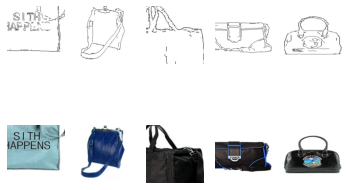

In [28]:
for i in range(0,n_samples): 
  plt.subplot(2, n_samples, i+1)
  plt.imshow(edges_train[2200+i] * 0.5 + 0.5)
  plt.axis('off')

for i in range(0,n_samples):
  plt.subplot(2,n_samples, 1+n_samples+i)
  plt.imshow(target_train[2200 + i] * 0.5 + 0.5)
  plt.axis('off')

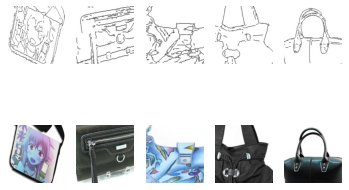

In [29]:
for i in range(0,n_samples): 
  plt.subplot(2, n_samples, i+1)
  plt.imshow(edges_val[20+i] * 0.5 + 0.5)
  plt.axis('off')

for i in range(0,n_samples):
  plt.subplot(2,n_samples, 1+n_samples+i)
  plt.imshow(target_val[20 + i] * 0.5 + 0.5)
  plt.axis('off')

Como se aprecia, las imágenes añadidas aparecen recortadas y algunas de ellas giradas horizontalmente. Además existe correspondencia entre los conjuntos guardados de bocetos y *targets*

Con tal de tener las imágenes en el formato adecuado demandado por el generador y discriminador ``(None, 256, 256, 3)``, se realiza un ``reshape`` de las imágenes. La primera dimensión se establece a 1, como si fuera el tamaño de batch.

In [30]:
edges_train = np.reshape(edges_train, (edges_train.shape[0], 1, 256, 256, 3))
target_train = np.reshape(target_train, (target_train.shape[0], 1, 256, 256, 3))
edges_val = np.reshape(edges_val, (edges_val.shape[0], 1, 256, 256, 3))
target_val = np.reshape(target_val, (target_val.shape[0], 1, 256, 256, 3))

Se comprueba rápidamente que estén en el formato requerido. Y así es. 

In [31]:
edges_train.shape, target_train.shape

((2287, 1, 256, 256, 3), (2287, 1, 256, 256, 3))

In [32]:
edges_val.shape , target_val.shape

((25, 1, 256, 256, 3), (25, 1, 256, 256, 3))

#### Generación datasets de TensorFlow

Finalmente, una vez se tienen las imágenes dispuestas en los formatos requeridos en dividas en los conjuntos oportunos (boceto-*target*, entrnamiento-test), se guardan en un objeto ``Dataset`` de TensorFlow. Este paso es necesario ya que el resto del código da por supuesto que los dataset están en este formato, haciendo uso de funciones como ``take`` propias de este tipo de objetos. Se hace uso de la función ``from_tensor_slices`` de la librería ``Dataset`` para llevar a cabo este paso.  

Antes de nada, se convierten los conjuntos de imágenes de arrays de numpy a tensores de TensorFlow. Esto es lo recomendado en la página de la plataforma cuando se quiere generar un objeto ``Dataset`` a partir de arrays numpy grandes. De lo contrario, se han experimentado fallos por falta de memoria en algunos pasos posteriores. 

In [33]:
edges_train = tf.convert_to_tensor(edges_train, dtype = tf.float32)
target_train = tf.convert_to_tensor(target_train, dtype = tf.float32)
edges_val = tf.convert_to_tensor(edges_val, dtype = tf.float32)
target_val = tf.convert_to_tensor(target_val, dtype = tf.float32)

Se generan los objetos ``Dataset``

In [34]:
train_dataset = tf.data.Dataset.from_tensor_slices((edges_train, target_train))
test_dataset = tf.data.Dataset.from_tensor_slices((edges_val, target_val))

Se realiza una comprobación visual rápida de que las imágenes se han guardado correctamente.

Data type:  <dtype: 'float32'> <class 'tensorflow.python.framework.ops.EagerTensor'>


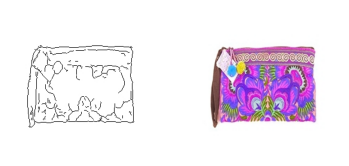

In [35]:
for example_input, example_target in train_dataset.take(1):
  print('Data type: ',example_target.dtype, type(example_target))
  fig,axs = plt.subplots(1,2)
  example_input = tf.reshape(example_input, (256,256,3))
  axs[0].imshow(example_input * 0.5 + 0.5)
  axs[0].axis('off')
  example_target = tf.reshape(example_target, (256,256,3))
  axs[1].imshow(example_target * 0.5 + 0.5)
  axs[1].axis('off')

Data type:  <dtype: 'float32'> <class 'tensorflow.python.framework.ops.EagerTensor'>


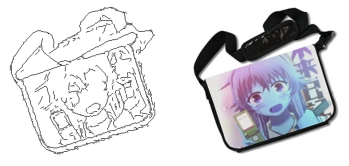

In [36]:
for example_input, example_target in test_dataset.take(1):
  print('Data type: ',example_target.dtype, type(example_target))
  fig,axs = plt.subplots(1,2)
  example_input = tf.reshape(example_input, (256,256,3))
  axs[0].imshow(example_input * 0.5 + 0.5)
  axs[0].axis('off')
  example_target = tf.reshape(example_target, (256,256,3))
  axs[1].imshow(example_target * 0.5 + 0.5)
  axs[1].axis('off')

In [37]:
BUFFER_SIZE = 400
BATCH_SIZE = 1
IMG_WIDTH = 256
IMG_HEIGHT = 256

## Construcción del Generador
  * La arquitectura del generador es una U-Net modificada.
  * Cada bloque del encoder consta de (Conv -> Batchnorm -> Leaky ReLU)
  * Cada bloque del decoder consta de (Transposed Conv -> Batchnorm -> Dropout(aplicado a los 3 primeros bloques) -> ReLU)
  * Hay *skip connections* entre encoder y decoder, como en la U-Net.
  


In [38]:
OUTPUT_CHANNELS = 3

In [39]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [40]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [41]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256,256,3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False), # (bs, 128, 128, 64)
    downsample(128, 4), # (bs, 64, 64, 128)
    downsample(256, 4), # (bs, 32, 32, 256)
    downsample(512, 4), # (bs, 16, 16, 512)
    downsample(512, 4), # (bs, 8, 8, 512)
    downsample(512, 4), # (bs, 4, 4, 512)
    downsample(512, 4), # (bs, 2, 2, 512)
    downsample(512, 4), # (bs, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True), # (bs, 2, 2, 1024) 
    upsample(512, 4, apply_dropout=True), # (bs, 4, 4, 1024) 
    upsample(512, 4, apply_dropout=True), # (bs, 8, 8, 1024)
    upsample(512, 4), # (bs, 16, 16, 1024)
    upsample(256, 4), # (bs, 32, 32, 512)
    upsample(128, 4), # (bs, 64, 64, 256)
    upsample(64, 4), # (bs, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh') # (bs, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1]) # la ultima capa no pilla el skip ya que es el cuello de botella

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

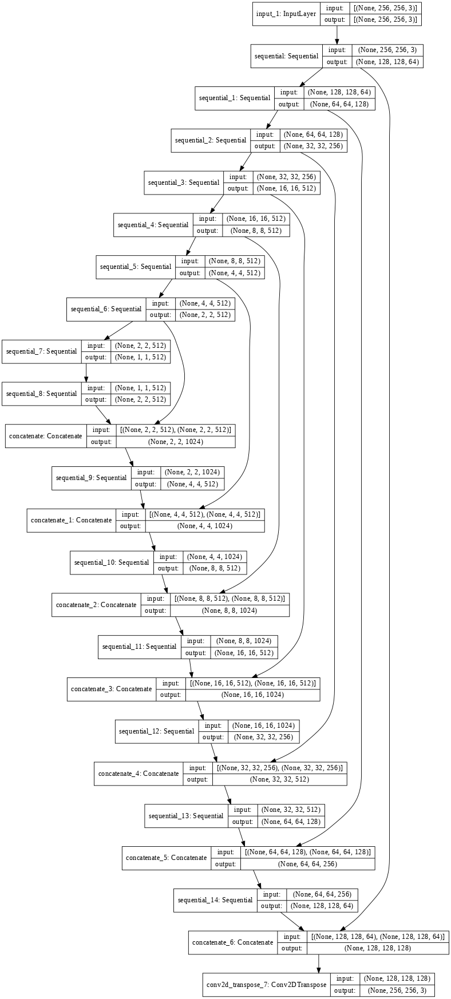

In [42]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

Se prueba el generador con una imagen del conjunto de entrenamiento. Además se valida la forma del tensor de salida así como el tipo de dato.

In [43]:
for (example_input, example_output) in train_dataset.take(1):
  print('Type: ', example_input.dtype)
  gen_output = generator(example_input, training=False)

Type:  <dtype: 'float32'>


In [44]:
print(tf.shape(gen_output).numpy())

[  1 256 256   3]


In [45]:
print(gen_output.dtype)

<dtype: 'float32'>


(-0.5, 255.5, 255.5, -0.5)

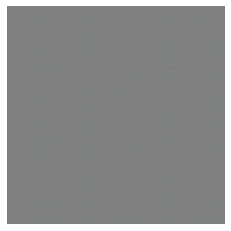

In [46]:
plt.clf()
gen_output = tf.reshape(gen_output, [256,256,3])
plt.imshow(gen_output * 0.5 + 0.5) 
plt.axis('off')

### Pérdida del Generador
  * Consta de la entropía cruzada sigmoidal de las imágenes generadas y un **array de 1s**.
  * El [paper](https://arxiv.org/abs/1611.07004) also includes L1 loss which is MAE (mean absolute error) también incluye la pérdida L1 (MAE) entre la imagen generada y la imagen objetivo.
   
  * Esto permite a la imagen generada poseer una estructura similar a la imagen original.

  * La formula para calcular la pérdida total del generador es = gan_loss + LAMBDA * l1_loss, donde LAMBDA = 100. Este valor fue el escogido por los autores del [paper](https://arxiv.org/abs/1611.07004).

**Detalle sobre la implementación de la pérdida L1 o MAE** 

La pérdida L1 o MAE se expresa como $\mathbb{E}_{x,y,z}||y - G(x,z)||$, donde $y$ es la imagen real y $G(x,z)$ la imagen generada. Al tratarse de una resta entre valores de una imagen, ambas deben estar expresadas en el mismo dominio. El generador tiene como función de activación en la capa de salida la tangente hiperbólica, generando imágenes en el dominio [-1,1]. Así pues, para que el cálculo de esta pérdida sea coherente, la imagen real debe estar en el mismo dominio. No solo eso, sino que además al realizarse una resta de tensores ambos deben estar construidos con el mismo tipo de datos. En este caso, el generador tiene como salida una imagen ``float32``, por lo que la imagen del mundo real debe ser de este mismo tipo de datos. Este tipo de detalles es lo que han dado pie a la mayoría de experimientos o experiencias que se describen al final del capítulo. 

Es por todo ello que ahora sí que quedan justificados los cambios de dominio y tipo de datos sobre las imágenes realizados en la función ``load_images`` del principio. 

El proceso de entrenamiento del generados se muestra en la figura de abajo. 

In [48]:
LAMBDA = 100

In [49]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

![Generator Update Image](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/gen.png?raw=1)


## Construcción del Discriminador
  * El discriminador es un PatchGAN.
  * Cada bloque consiste en (Conv -> BatchNorm -> Leaky ReLU)
  * El tamaño de la salida es (batch_size, 30, 30, 1)
  * Cada parche 30x30 de la salida clasifica una porción de  70x70 de la imagen de entrada (esta arquitectura recibe el nombre de PatchGAN).
  * El discriminador recibe dos entradas.
    * El boceto y la imagen del mundo real, la cual debería clasificar como real.
    * El boceto y la imagen generada (salida de *G*), la cual debería clasificar como falsa.
    * Estos dos entradas se concatenan en el código (`tf.concat([inp, tar], axis=-1)`)

In [50]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image') 

  x = tf.keras.layers.concatenate([inp, tar]) # (bs, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x) # (bs, 128, 128, 64)
  down2 = downsample(128, 4)(down1) # (bs, 64, 64, 128)
  down3 = downsample(256, 4)(down2) # (bs, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1) # (bs, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

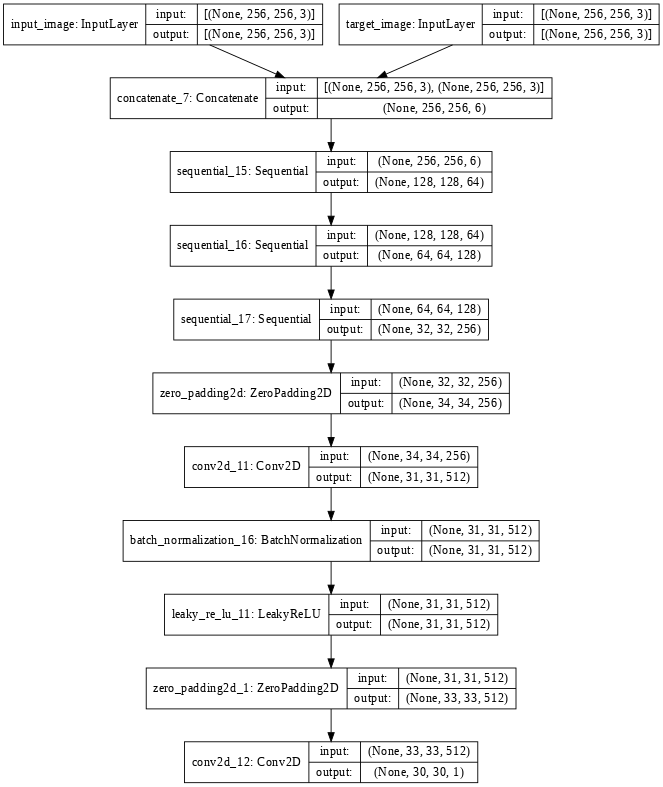

In [51]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

Se realiza una primera evaluación del discriminador y su salida para comprobar que no hay fallos en el código. 

<dtype: 'float32'>


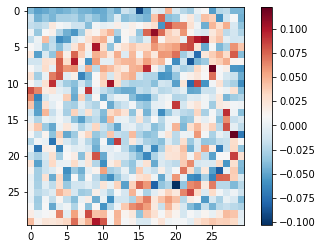

In [52]:
for (example_input, example_target) in test_dataset.take(1): 
  disc_out = discriminator([example_input, example_target], training=False)
  output = tf.reshape(disc_out, (30,30))
  print(output.dtype)
  min = tf.math.reduce_min(output).numpy()
  max = tf.math.reduce_max(output).numpy()
  plt.imshow(output, vmin= min, vmax= max, cmap='RdBu_r')
  plt.colorbar()

**Pérdida del discriminador**
  * La función de pérdida del discriminador toma dos entradas; **imágenes reales, imágenes generadas**
  * *real_loss* consiste una entropía cruzada sigmoidal de las  **imágenes reales** y un **array de 1s (ya que estas son las imágenes reales)**
  * *generated_loss* consiste una entropía cruzada sigmoidal de las **imágenes_generadas** y un  **array de 0s (ya que estas son las imágenes falsas)**
  * Así pues la  *total_loss* es la suma de la *real_loss* y de la *generated_loss*


In [53]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [54]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

El proceso de entrenamiento del discriminador se muestra a continuación. 

![Discriminator Update Image](https://github.com/tensorflow/docs/blob/master/site/en/tutorials/generative/images/dis.png?raw=1)


## Definición de los Optimizadores y del Checkpoint-saver


In [55]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [56]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

## Generación de imágenes

Se define una función para plotear imágenes durante el entrenamiento.

* Se pasan imágenes del conjunto de test al generador.
* El generador mapeará el vector de entrada (boceto) a un espacio de salida (imagen generada).
* El último paso es mostrar la imagen generada y **voila!**

Nota: El parámetro ``training=True``es intencionado ya que se pretenede que se empleen los estadísticos procedentes del conjunto de test cuando se corre el modelo, y no los aprendidos durante el entrenamiento. 

In [57]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15,15))

  #plot_prediction = tf.reshape(prediction, [256,256,3])
  #plot_test_input = tf.reshape(test_input, [256,256,3])
  #plot_tar = tf.reshape(tar, [256,256,3])
 # plot_prediction = plot_prediction * 0.5 + 0.5
  display_list = [test_input[0], tar[0], prediction[0]]
 # display_list = [tf.cast(plot_test_input, tf.uint8), tf.cast(plot_tar, tf.uint8), plot_prediction * 0.5 + 0.5] #input = float32
  #display_list = [plot_test_input, plot_tar, plot_prediction * 0.5 + 0.5] #input = uint8
 # display_list = [plot_test_input, plot_tar, tf.nn.relu(plot_prediction)] #ReLu para la salida
  #display_list = [plot_test_input, plot_tar, plot_prediction]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    #image_plot = np.reshape(display_list[i], (256,256,1))
    #plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.imshow(display_list[i] * 0.5 + 0.5)
    #plt.imshow(image_plot * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

Se hace una primera de prueba de cómo funciona el generador. Tal y como se espera, genera una imagen muy poco realista ya que aun no se han entrenado los pesos de la red o aquellos parámetros de la función de mapeo de una distribución de entrada a la distribución de salida (la cual debería ser muy cercana a la real una vez acabado el entrenamiento)

Sin embargo, es curioso observar como la entrada condiciona la salida incluso con el generador sin entrenar. En la imagen de salida puede observarse como la silueta del boceto. 

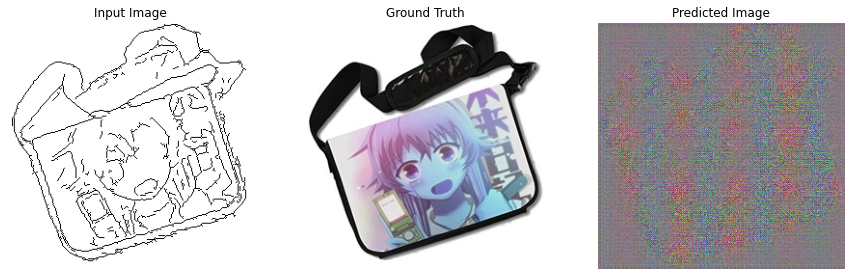

In [58]:
for example_input, example_target in test_dataset.take(1):
  generate_images(generator, example_input, example_target)

## Entrenamiento

* Por cada boceto se genera una imagen.
* El discriminador recibe como primer input el boceto y la imagen generada. El segundo input es el boceto y la imagen real.
* A continuación se calcula la pérdida del generador y del discriminador.
* Después se calculan los gradientes de la función de pérdida de cada modelo y se aplican al optimizador.
* Finalmente se cargan estos valores a TensorBoard.

Se define el número de épocas a realizar. Con tal de no pasar un tiempo excesivo entrenando el modelo, y después de varios experimientos con diferentes número de épocas, se considera que 20 es un número adecuado. 

In [59]:
EPOCHS = 20 

In [60]:
import datetime
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [61]:
@tf.function
def train_step(input_image, target, epoch):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
    tf.summary.scalar('disc_loss', disc_loss, step=epoch)

El bucle de entrenamiento consiste en los siguientes pasos:

* Se itera sobre el conjunto de entranamiento tantas veces como épocas se haya definido.
* A cada época se resetea la salida estándar y se ejecuta ``generate_images`` para mostrar el progreso del modelo. ``generate_images`` siempre mostrará la misma imagen, por lo que será claro seguir dicho progreso. 
* En cada época se recorre el conjunto entero de entrenameinto, imprimiendo un '.' en cada ejemplo visto.
* Se guarda un checkpoint cada 20 épocas.

In [62]:
def fit(train_ds, epochs, test_ds):
  for epoch in range(epochs):
    start = time.time()

    display.clear_output(wait=True)

    for example_input, example_target in test_ds.take(1):
      generate_images(generator, example_input, example_target)
    print("Epoch: ", epoch)

    # Train
    for n, (input_image, target) in train_ds.enumerate():
      print('.', end='')
      if (n+1) % 100 == 0:
        print()
      train_step(input_image, target, epoch)
    print()

    # saving (checkpoint) the model every 20 epochs
    if (epoch + 1) % 20 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))
  checkpoint.save(file_prefix = checkpoint_prefix)

El proceso de entrenamiento guarda valores en TensorBoard de tal manera que este se puede monitorizar.

A continuación se lanza el visor de TensorBoard:

In [63]:
#docs_infra: no_execute
%load_ext tensorboard
%tensorboard --logdir {log_dir}

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

Se procede a entrenar la red

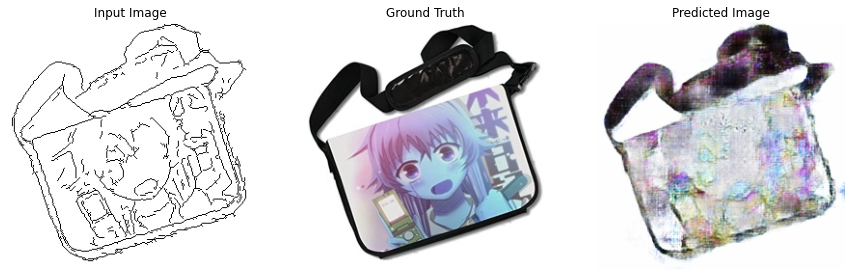

Epoch:  19
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
................................................................................

In [64]:
fit(train_dataset, EPOCHS, test_dataset)

## Evaluación del modelo usando el conjunto de validación

La evaluación del modelo se realiza mediante inspección visual. Es por ello que no tiene sentido tener un conjunto de test muy grande, con unas cuantas imágenes ya basta para ver el desempeño del generador. 

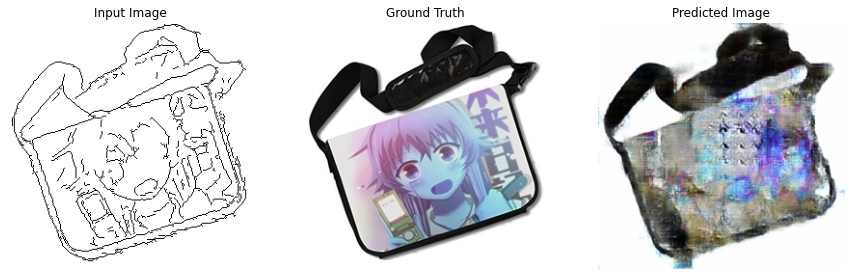

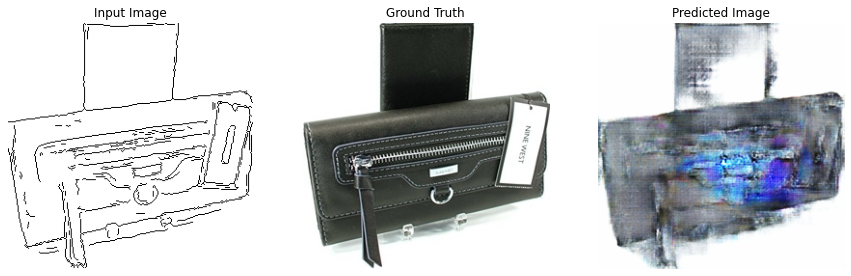

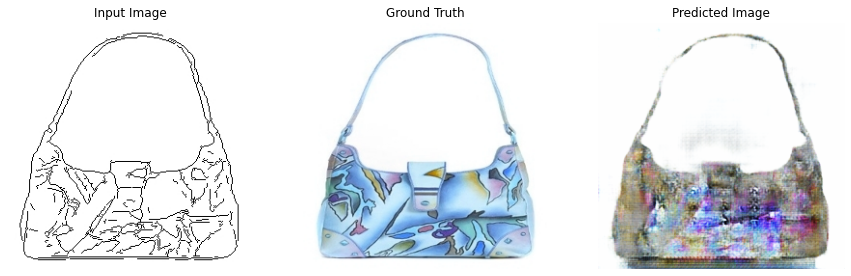

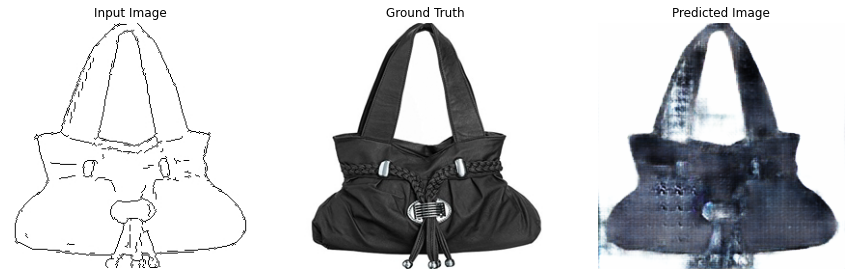

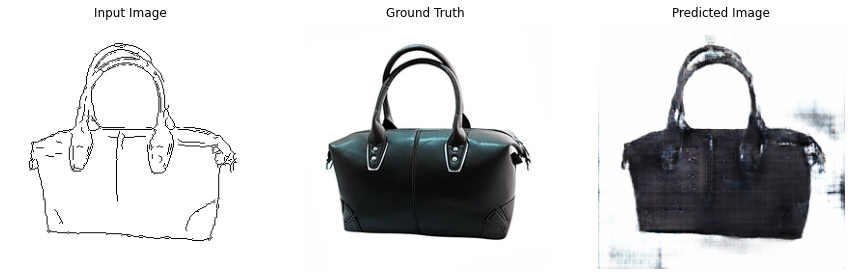

...

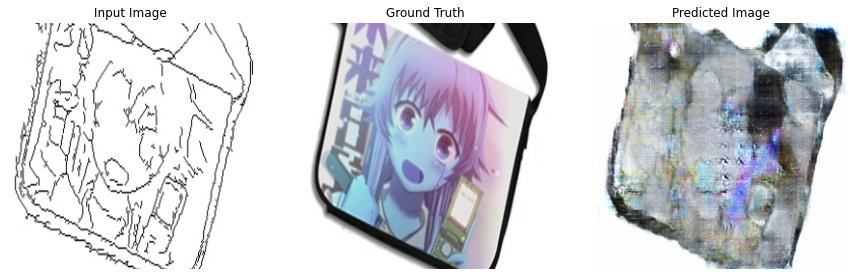

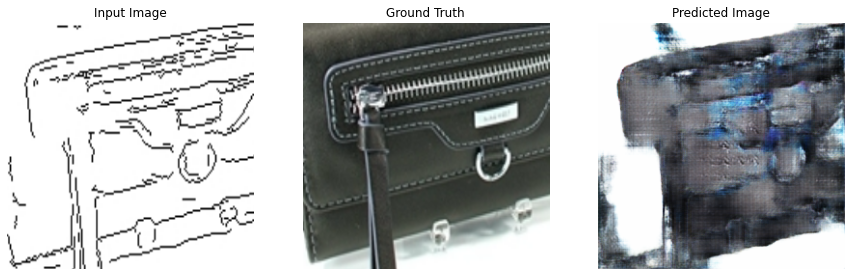

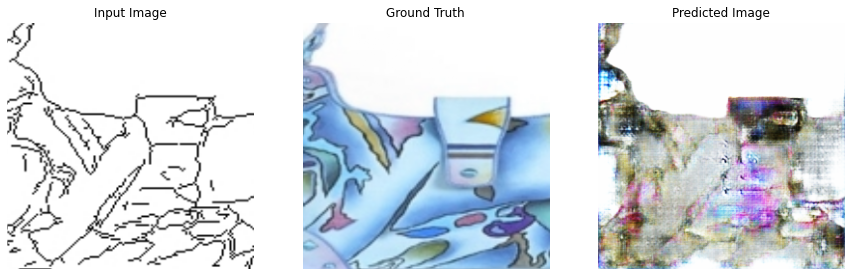

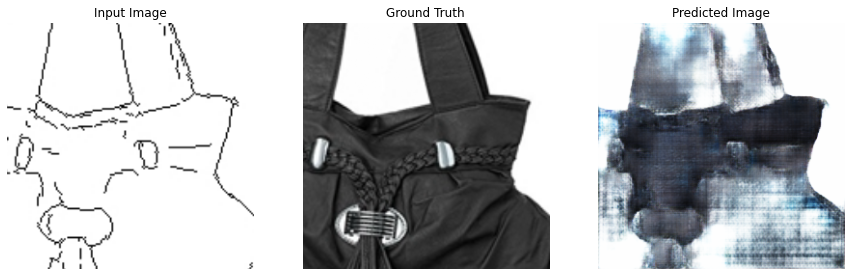

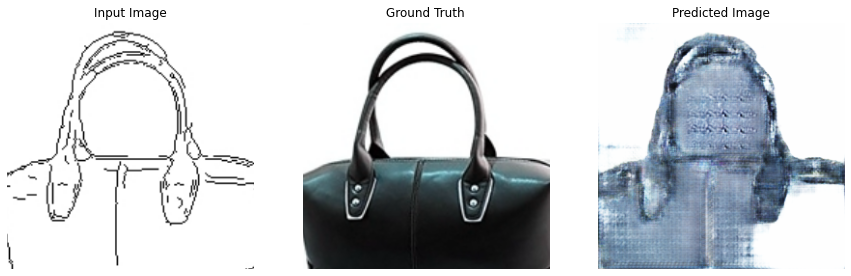

In [65]:
# Run the trained model on a few examples from the test dataset
for inp, tar in test_dataset.take(25):
  generate_images(generator, inp, tar)

Para hacerse una idea de cómo se adapta el modelo a los datos de entrenamiento con tal de observar si los resultados son mejores (sería lo normal), se visualizan las imágenes generadas empleando el conjunto de entrenamiento. 

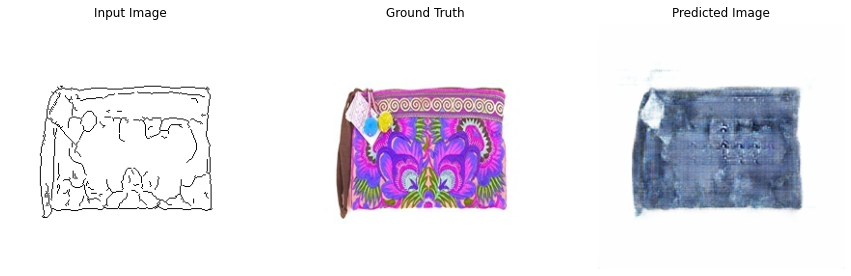

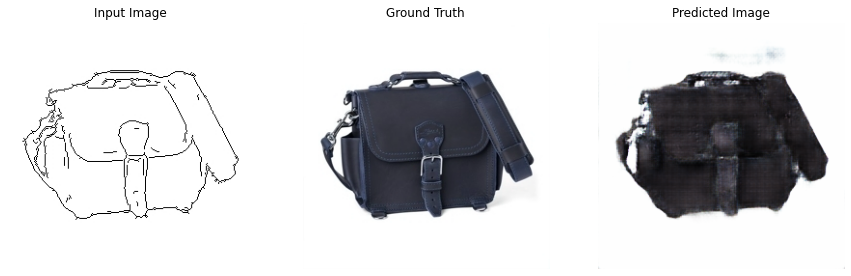

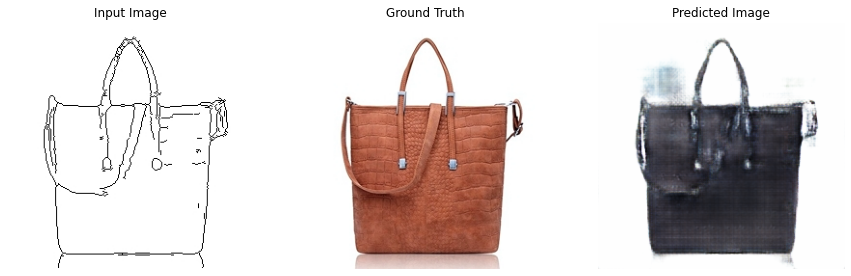

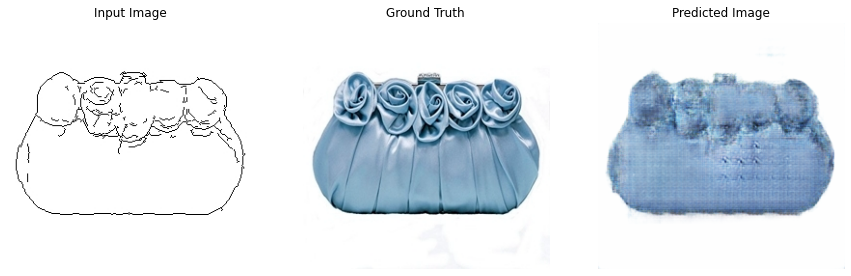

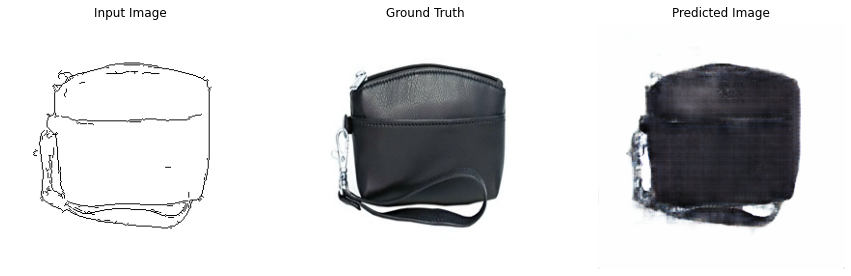

...

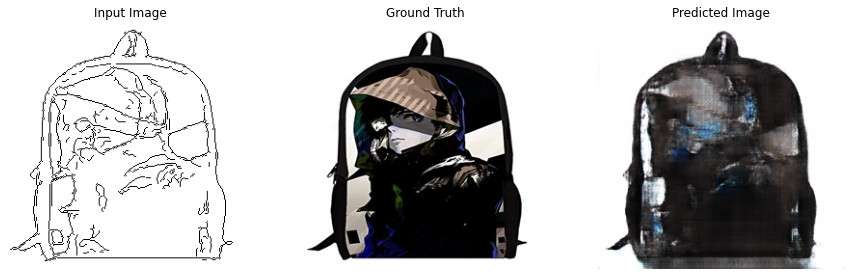

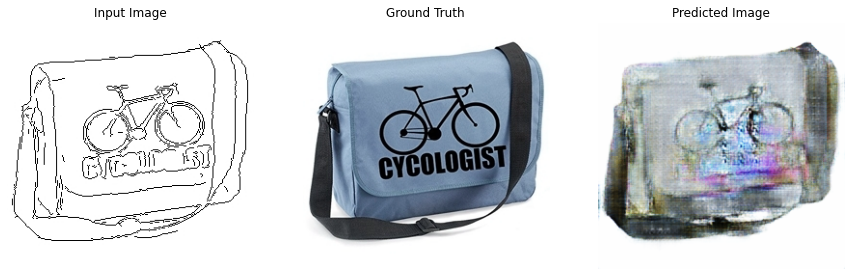

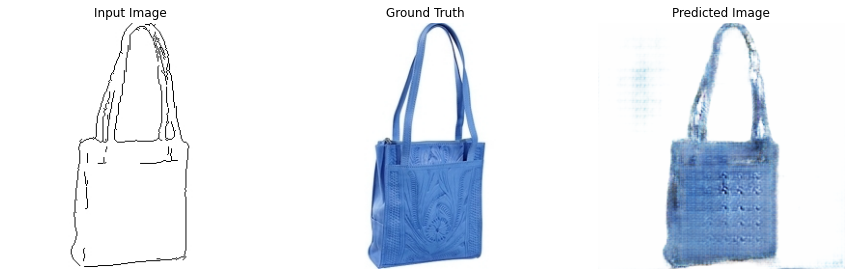

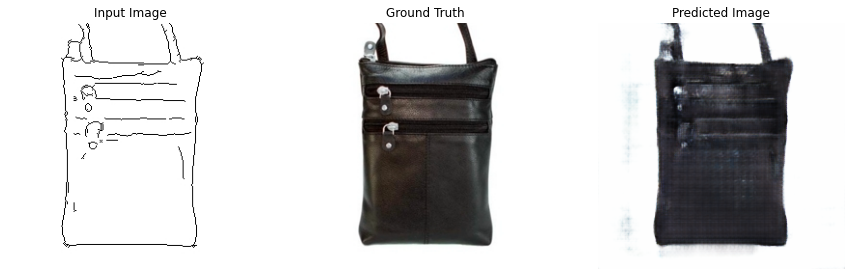

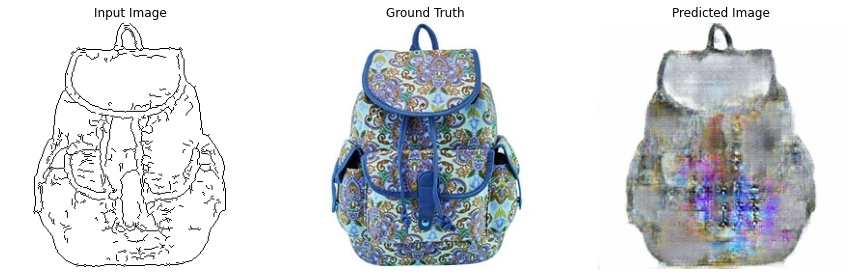

In [66]:
for inp, tar in train_dataset.take(25):
  generate_images(generator, inp, tar)

## Observaciones sobre los resultados

Como puede apreciarse los resultados están lejos de poder caracterizarse como realistas. Especialmente en aquellos artículos que presentan colores, estampados, personas, algún tipo de dibujo, etc. En definitiva, aquellos artículos no lisos. Aún así, en los bolsos más simples, los pequeños detalles como cierres o cremalleras no aparecen bien representados. 

Los motivos por los cuales sucede esto, podrían atribuirse a una cantidad reducida de imágenes de entrenamiento y, además, pocas épocas. Es cierto que otros modelos como la U-Net ha requerido de menos imágenes para funcionar correctamente. Sin embargo, podría decirse que la complejidad de este modelo y la tarea a realizar son mucho mayores a la segmentación realizada con la U-Net. Por otra parte, observando el tamaño del conjunto de entrenamiento oficial (cerca de 190000 imágenes), podría decirse que quizás este tamaño no sea algo arbitrario; que realmente se podría necesitarse una alta cantidad (aunque no todas) de imágenes y tiempo para que esta red genere artículos realistas. Aunque esto último es solo una hipótesis. 

En cuánto al comportamiento del modelo durante el entrenamiento, se puede decir que el discriminador está dominando al generador, ya que este primero presenta un valor de la función de pérdida mucho más bajo que el generador. Por lo tanto podría decirse que, para el número de épocas e imágenes consideradas, el entrenamiento no ha ido como se esperaba. Por otra parte, la pérdida L1 del generador presenta una tendencia decreciente a lo largo del entrenamiento. Esto significa que las imágenes creada cada vez presentan una estructura más similar a la real. Eso es buen indicativo. Estos datos refuerzan la idea de que más imágenes y épocas podrían mejorar considerablemente el rendimiento del modelo. 

Dotar de más épocas al entrenamiento podría ser factible, ya que es únicamente cuestión de tiempo. De hecho, se han probado en experimentos anteriores de la práctica hasta 50 épocas. Aún así no se observaban resultados significativamente mejores. Sin embargo, por otra parte, tal y como se ha estructurado el código, el uso de más imágenes hubiera desembocado en fallos de memoria. Esto podría solucionarse con un generador como los empleados en anteriores prácticas. 

Finalmente cabe destacar que los resultados incluyendo las imágenes transformadas por el proceso de *random jittering* son peores que cuando no se incluyen. Y eso que solo se han incluido un 10% del total del conjunto de entrenamiento final. 

## Experimentos realizados

A lo largo de la realización de esta práctica, se han realizado diferentes experimentos con tal de hacer funcionar la GAN o mejorar su rendimiento. Se comentarán brevemente alguno de los pasos seguidos en el proceso de experimentación: 

1. Lo primero a destacar es el enorme tamaño del conjunto de datos de entrenamiento. Al observar este hecho, se fue experimentando con el tamaño de datos seleccionado con tal de que no sucediesen fallos de memoria. Al final, a través de ir guardando arrays de numpy como ``.npz`` y borrando variables con ``del`` se consiguió ejecutar el programa sin fallo. El tamaño final seleccionado es el justo para que, tal como está estructurado el código, no den problemas de insuficiencia de memoria. 

2. A continuación, cuando se consiguió cargar correctamente el conjunto de datos como un objeto ``Dataset`` de TensorFlow, saltaba un error en el entrenamiento. En la périda L1 los tensores representantes de ambas imágenes (generada y real) debían tener el mismo tipo de datos. Como la imagen generada era ``float32``, se hizo un casting de la imagen original cargada a ``float32``. El dominio seguía siendo [0.0, 255.0].

3. Después de ello, el generador solo lograba crear imágenes todas en blanco. Observando las gráficas de las pérdidas en el TensorBoard, me percaté de que la pérdida L1 del generador era enorme, del orden de 200. Además, este valor multiplicado por una LAMBDA de 100, elevaba el error total del generado a valores de maginitud $10^4$. Al final me di cuenta que esto sucedía porque las imágenes cargadas estaban expresadas en el dominio [0.0,255.0], y las generadas en el dominio [-1,1]. Es por ello que al realizar el valor absoluto de su resta píxel a píxel, el valor del MAE se elevaba a valores de 200 o más. La solución al principio fue poner las imágenes en un dominio [0,1]. No se describió la imagen en [-1,1] por que me resultaron extraños estos valores para una imagen, aunque el generador era lo que creaba. 

4. Cuando se puso la imagen en el dominio [0,1], los resultados eran mucho mejores que imágenes en blanco. Sin embargo aun eran mejorables. En este momento se realizó la siguiente hipótesis: ** si las imágenes generadas estaban en el dominio [-1,1] y las originales en el [0,1], sería muy fácil para el discriminador saber cual es cual, ya que sus distribuciones son distintas. Además, esto implicaría que el generador adaptase su salida al rango [0,1] para burlar al discriminador y tambien generar imágenes con una estructura más parecida a las originales (por el MAE).** A fin de cuentas, la salida del generador estaría en [0,1] de manera forzada por las funciones de pérdida. Siguiendo a esto, se observó que aquellos objetos que debían ser negros, salían demasiado grises. Me di cuenta que para representar las imágenes en la función ``generate_images``, se realizaba una transformación lineal a las imágenes de la forma $I_{out} = 0.5I_{in} + 0.5$, donde el intercepto es 0.5. De tal forma que si por una lado, al final del entrenamiento el generador crearía imágenes entre [0,1] y, por otro lado, para representarlas se haría primero la transformación dicha, aquellos valores que debían ser 0 serían 0.5, creando imágenes más claras o grises. Quizás las poco realistas imágenes creadas sufrían de un problema de representación, no de modelo. Por este motivo, se consideró aplicar una función ReLu a la imagen generada con la función ``tf.nn.relu`` antes de mostrarla por pantalla, de tal forma que al final del entrenamiento las imágenes entre [0,1] no sufrirían ninguna transformación al ser representadas. No obstante, esto no pareció solucionar nada. Los resultados seguían siendo vulgares. 

5. Al observar que no había cambios significativos, se probó cambiar la función de activación de la última capa del generador de una ``tanh`` a una ``sigmoid``, y así tener la imagen generada y la real en el mismo dominio [0,1].  Sin embargo, los resultados no fueron mejores. Las imágenes finales presentaban muchas irregularidades en zonas donde la imagen orginal era plana en cuanto a color y textura. Por este motivo, se decidió finalmente probar con imágenes en el dominio [-1,1] y con la función de activación ``tanh``. Si estaba así desde un principio, sería por algo. 

4. Esta última modificación es la que aparece reflejada en el documento final. Los resultados, tal y como se ha comentado, son muy mejorables. Sin embargo, han sido los mejores que se han obtenido hasta el momento. Por lo menos, las zonas planas en la imagen original más o menos se mantienen en la imagen creada, la cual es la gran diferencia entre usar la ``tanh`` o la sigmoide. Al final, el obtener mejores resultados puede depender en gran medida de entrenar más épocas con más imágenes.   

## Conclusiones

A parte de todas aquellas observaciones y experimentos descritos anteriomente, se quiere volver a remarcar la idea de que los resultados no son buenos. No se han generado imágenes realistas. Y las causas de esto pueden radicar principalmente en la escasez del entrenamiento: pocas épocas y pocas imágenes. Además, la escasez de imágenes podría venir justificada por la enorme cantidad de imágenes incluídas en el conjunto inicial de entrenamiento. Dicha cantidad puede no ser meramente una cuestión de 'decoración'. Quizás sean necesarias gran parte de estas. 